In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.signal as sg
from scipy.fft import rfft,irfft, rfftfreq 
import IPython.display as ipd
import librosa
import librosa.display

# **Reading a Sound Signal**

### Reading a Sound file 

In [ ]:
data, sample_rate = librosa.load('c13.wav', sr=None)
print(f"Sample rate = {sample_rate}, number of data = {len(data)}\n")

ipd.display(ipd.Audio(data,rate=sample_rate))

Sample rate = 44100, number of data = 573300



##Ploting sound and its frequency

In [ ]:
#function for ploting frequency, by using FFT
def fft_plot(audio, sr, title=None):
    n = len(audio)
    T = 1 / sr
    yf = rfft(audio)
    xf = rfftfreq(n,T)
    plt.figure(figsize=(14, 5))
    plt.plot(xf,np.abs(yf))
    plt.grid()
    plt.title(title)
    plt.xlabel('Frequency')
    # plt.ylabel('Amplitude')
    plt.show()

In [ ]:
def amp_plot(data,sr, title=None):
  plt.figure(figsize=(14, 5))
  librosa.display.waveplot(data, sr=sample_rate)
  plt.grid()
  plt.title(title)
  plt.show()

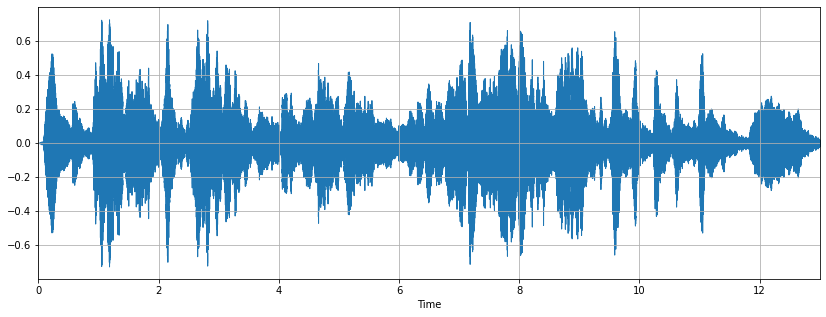

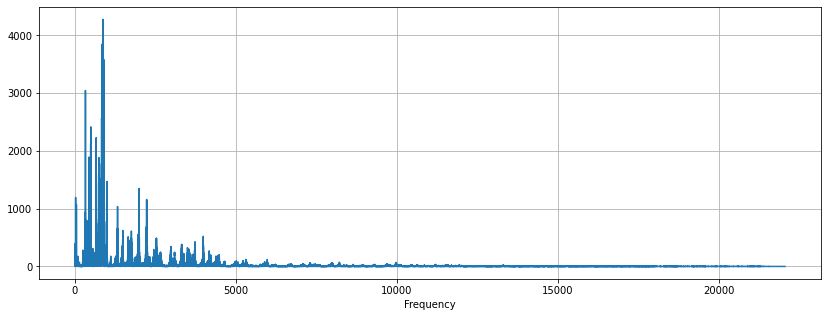

In [ ]:
amp_plot(data, sample_rate)
fft_plot(data, sample_rate)

# **Changing sample rate to produce aliasing**

In [ ]:
data2 = data
sr = sample_rate
length = len(data)

for i in range(5):
    print(f"\nsample rate = {sr}, number of samples = {len(data2)}")
    data_for_play = sg.resample(data2 ,length)
    ipd.display(ipd.Audio(data_for_play, rate=sample_rate))
    
    data2 = data2[::2]
    sr = sr // 2

    # fft_plot(data_for_play,sample_rate)
    # print('\n')



sample rate = 44100, number of samples = 573300



sample rate = 22050, number of samples = 286650



sample rate = 11025, number of samples = 143325



sample rate = 5512, number of samples = 71663



sample rate = 2756, number of samples = 35832


# **Changing the quantization rate to show the quality loss**

In [ ]:
def quantizer(data, n, min_, max_):
  norm_data = (data - min_)/(max_ - min_)
  norm_data = norm_data * (n-1)

  norm_data[norm_data > n-1] = n-1
  norm_data[norm_data < 0] = 0
  norm_data = np.round(norm_data)

  q_data = norm_data * (max_ - min_) / (n-1)
  q_data = q_data + min_

  return q_data

4294967296 quantization level, 32bits, SNR = 192 db


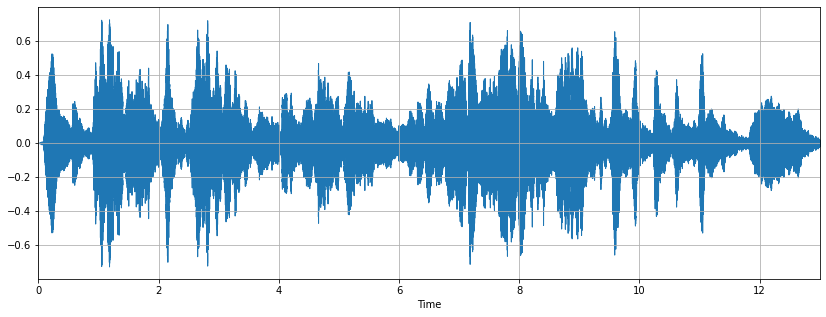

65536 quantization level, 16bits, SNR = 96 db


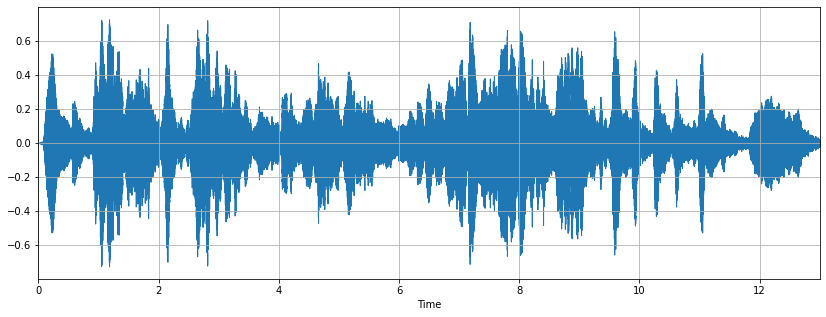

256 quantization level, 8bits, SNR = 48 db


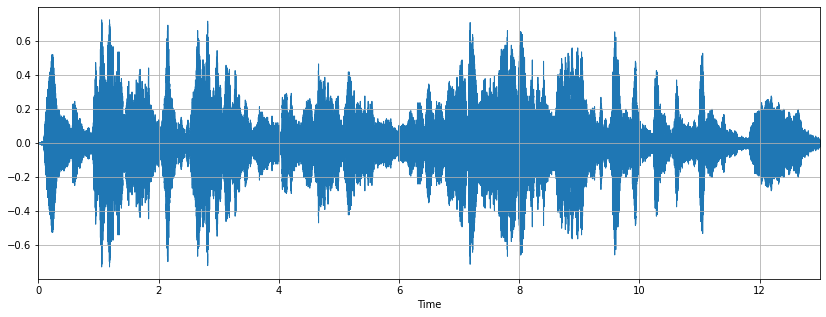

16 quantization level, 4bits, SNR = 24 db


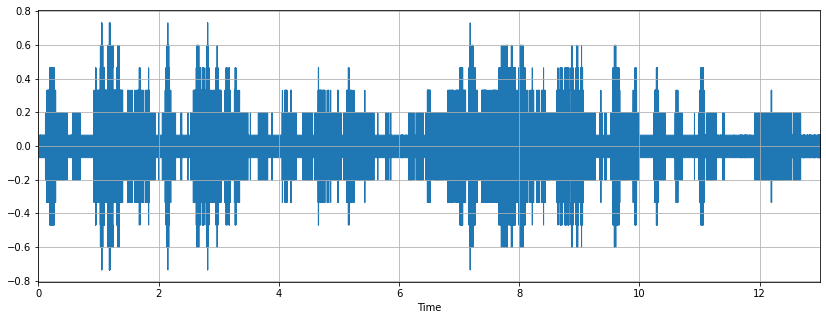

4 quantization level, 2bits, SNR = 12 db


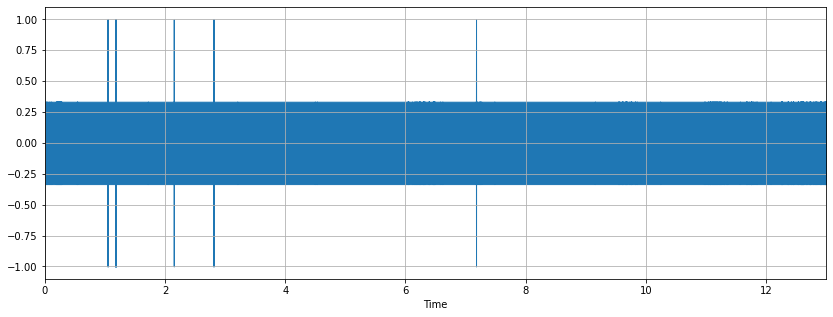

In [ ]:
for i in [32,16,8,4,2]:
  print(f"{2**i} quantization level, {i}bits, SNR = {6*i} db")
  quantization_data = quantizer(data, 2**i, -1,1)
  ipd.display(ipd.Audio(quantization_data, rate=sample_rate))
  amp_plot(quantization_data, sample_rate)
  



# **Adding noise and applaying filters**

## Adding noise

Noisy Sound:



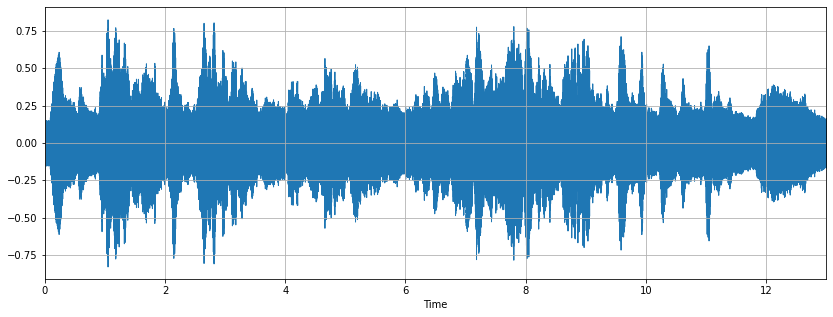

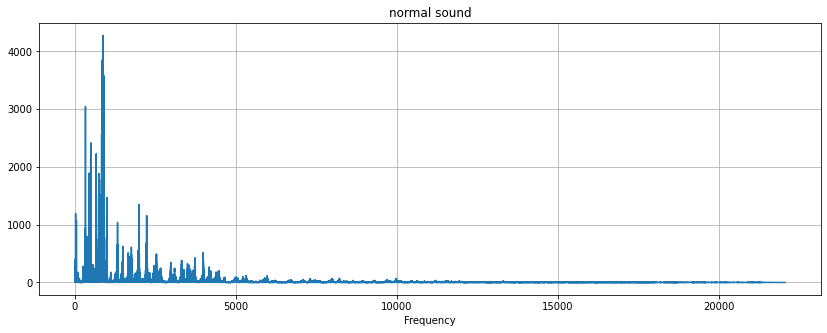

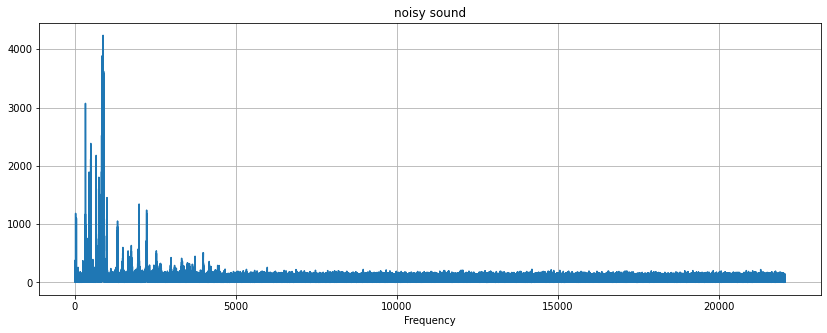

In [ ]:
noise = (np.random.rand(len(data))-0.5)*0.3
noisy_data = data + noise

print("Noisy Sound:\n")
ipd.display(ipd.Audio(noisy_data, rate=sample_rate))

#ploting noisy sound
amp_plot(noisy_data,sample_rate)
fft_plot(data, sample_rate, 'normal sound')
fft_plot(noisy_data,sample_rate, 'noisy sound')

## Making a lowpass filter with sinc function

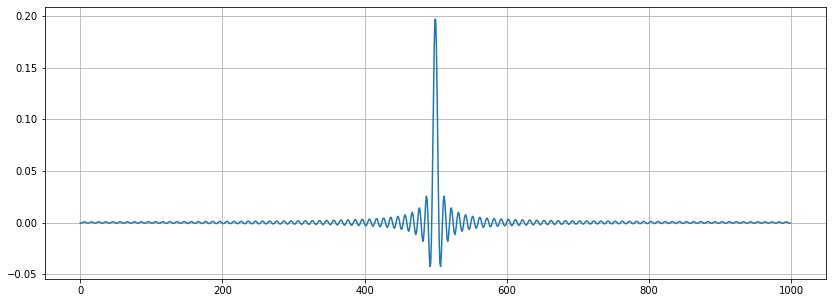

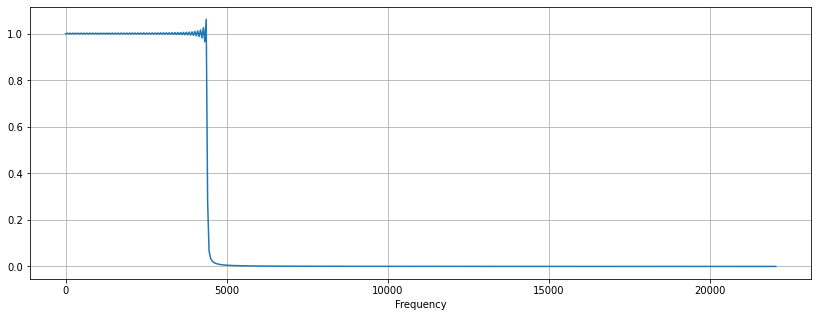

In [ ]:
N = 1000
x = np.arange(N)

cut_off_frequency = 4400

fc = cut_off_frequency/sample_rate

sinc_filter = 2 * sample_rate * np.sinc(2*fc * (x - (N-1)/2))

sinc_filter = sinc_filter / np.sum(sinc_filter)

plt.figure(figsize=(14, 5))
plt.plot(x, sinc_filter)
plt.grid()
plt.show()
fft_plot(sinc_filter, sample_rate)

## Applying Sinc filter (lowpass)

Noisy sound:


Filtered sound:


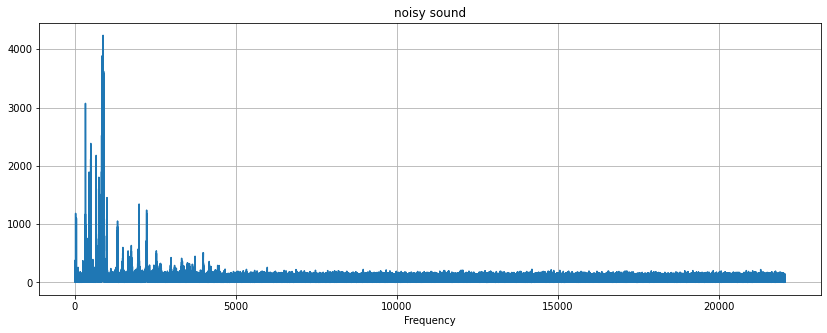

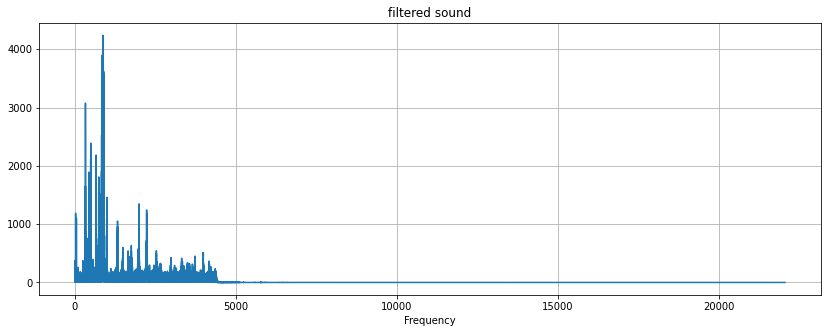

In [ ]:
filtered_data = sg.convolve(noisy_data, sinc_filter,'same')

print("Noisy sound:")
ipd.display(ipd.Audio(noisy_data, rate=sample_rate))

print("Filtered sound:")
ipd.display(ipd.Audio(filtered_data, rate=sample_rate))

fft_plot(noisy_data, sample_rate, "noisy sound")
fft_plot(filtered_data, sample_rate, "filtered sound")
